In [1]:
# uncomment this if you have cuda and want to specify the device
#import os
#os.environ["CUDA_VISIBLE_DEVICES"]="1"

In [2]:
import numpy as np
import cv2
import glob
import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt
import tqdm
import seaborn as sns
import torchvision
import torch
import PIL
from PIL import Image
import json

def show_image(image, figsize=(16, 9), reverse=True):
    plt.figure(figsize=figsize)
    if reverse:
        plt.imshow(image[...,::-1])
    else:
        plt.imshow(image)
    plt.axis('off')
    plt.show()

def save_to_json(filename, data):
    with open(filename, 'w') as f:
        return json.dump(data, f)
    
def load_from_json(filename):
    with open(filename, 'r') as f:
        return json.load(f)

/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Load COCO info

Useful links:
http://cocodataset.org/#home

In [3]:
coco_id_to_name = load_from_json("coco_id_to_name.json")

In [4]:
coco_id_to_name = {int(key): value for key, value in coco_id_to_name.items()}

In [5]:
len(coco_id_to_name)

80

In [6]:
list(coco_id_to_name.values())

['person',
 'bicycle',
 'car',
 'motorcycle',
 'airplane',
 'bus',
 'train',
 'truck',
 'boat',
 'traffic light',
 'fire hydrant',
 'stop sign',
 'parking meter',
 'bench',
 'bird',
 'cat',
 'dog',
 'horse',
 'sheep',
 'cow',
 'elephant',
 'bear',
 'zebra',
 'giraffe',
 'backpack',
 'umbrella',
 'handbag',
 'tie',
 'suitcase',
 'frisbee',
 'skis',
 'snowboard',
 'sports ball',
 'kite',
 'baseball bat',
 'baseball glove',
 'skateboard',
 'surfboard',
 'tennis racket',
 'bottle',
 'wine glass',
 'cup',
 'fork',
 'knife',
 'spoon',
 'bowl',
 'banana',
 'apple',
 'sandwich',
 'orange',
 'broccoli',
 'carrot',
 'hot dog',
 'pizza',
 'donut',
 'cake',
 'chair',
 'couch',
 'potted plant',
 'bed',
 'dining table',
 'toilet',
 'tv',
 'laptop',
 'mouse',
 'remote',
 'keyboard',
 'cell phone',
 'microwave',
 'oven',
 'toaster',
 'sink',
 'refrigerator',
 'book',
 'clock',
 'vase',
 'scissors',
 'teddy bear',
 'hair drier',
 'toothbrush']

# Sample run

In [7]:
file = 'detection_examples/mrs_maisel.jpg'

https://github.com/pytorch/vision/blob/c732dfe2a4b1c861d8d1fedd7999f473f8cd3142/torchvision/models/detection/faster_rcnn.py#L24

In [8]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True, progress=True,
                            num_classes=91, pretrained_backbone=True)

/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained_backbone' is deprecated since 0.13 and will be removed in 0.15, please use 'weights_backbone' instead.
  warnings.warn(
/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torchvision/models/_utils.

In [21]:
from torchvision import transforms

to_tensor = transforms.ToTensor()

def val_transform(img):
    img_tensor = to_tensor(img)
    return img_tensor.unsqueeze(0)

def visualize_prediction(file, model, device='cpu', verbose=True, thresh=0.0, n_colors=None):
    img = Image.open(file)
    img_tensor = val_transform(img)
    model.to(device)
    model.eval()
    with torch.no_grad():
        predictions = model(img_tensor.to(device)) # list of size 1
    prediction = predictions[0]
    
    if n_colors is None:
        n_colors = model.roi_heads.box_predictor.cls_score.out_features
    
    palette = sns.color_palette(None, n_colors)
    
    # visualize
    img = cv2.imread(file, cv2.COLOR_BGR2RGB)
    for i in range(len(prediction['boxes'])):
        x1, x2, x3, x4 = map(int, prediction['boxes'][i].tolist())
        label = int(prediction['labels'][i].cpu())
        score = float(prediction['scores'][i].cpu())
        name = coco_id_to_name[label]
        color = palette[label]
        if verbose:
            if score > thresh:
                print ('Class: {}, Confidence: {}'.format(name, score))
        if score > thresh:
            image = cv2.rectangle(img, (x1, x2), (x3, x4), np.array(color) * 255, 2)
            cv2.putText(image, name, (x1, x2-10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, np.array(color) * 255, 2)
    show_image(image)
    return prediction

In [22]:
file

'detection_examples/mrs_maisel.jpg'

In [23]:
img = Image.open(file)

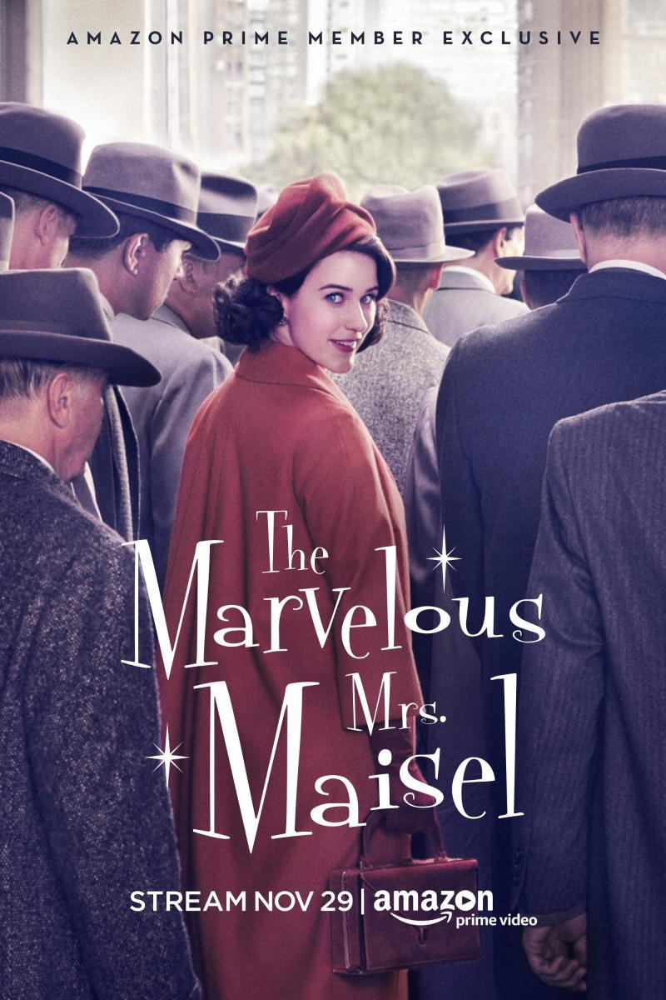

In [24]:
img

Class: person, Confidence: 0.9957577586174011
Class: person, Confidence: 0.9785687923431396
Class: person, Confidence: 0.9711195230484009
Class: person, Confidence: 0.9520587921142578
Class: person, Confidence: 0.9485946297645569
Class: person, Confidence: 0.9434380531311035
Class: person, Confidence: 0.9264217615127563
Class: person, Confidence: 0.9073954820632935
Class: person, Confidence: 0.7227161526679993
Class: person, Confidence: 0.6452577710151672
Class: person, Confidence: 0.6441429257392883
Class: tie, Confidence: 0.6039677858352661
Class: chair, Confidence: 0.40416061878204346
Class: person, Confidence: 0.4040903151035309
Class: person, Confidence: 0.40219777822494507
Class: person, Confidence: 0.36066585779190063
Class: person, Confidence: 0.32138341665267944
Class: person, Confidence: 0.31789758801460266
Class: person, Confidence: 0.30350980162620544
Class: person, Confidence: 0.28436383605003357
Class: chair, Confidence: 0.22806696593761444
Class: person, Confidence: 0.21

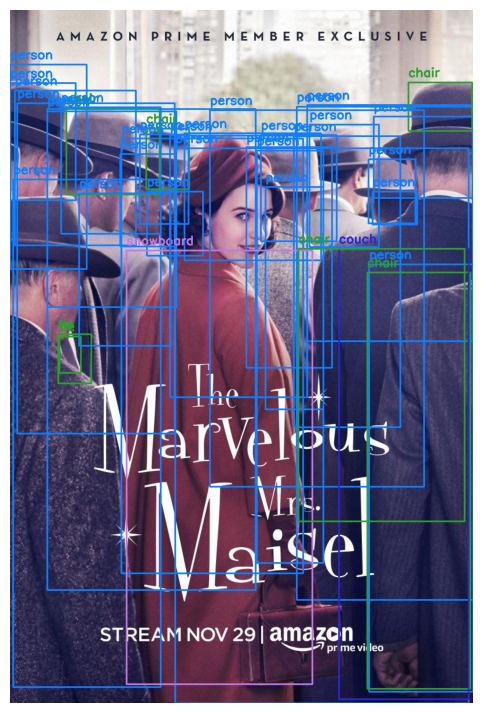

In [25]:
out = visualize_prediction(file, model)

Class: person, Confidence: 0.9957577586174011
Class: person, Confidence: 0.9785687923431396
Class: person, Confidence: 0.9711195230484009
Class: person, Confidence: 0.9520587921142578
Class: person, Confidence: 0.9485946297645569
Class: person, Confidence: 0.9434380531311035
Class: person, Confidence: 0.9264217615127563
Class: person, Confidence: 0.9073954820632935


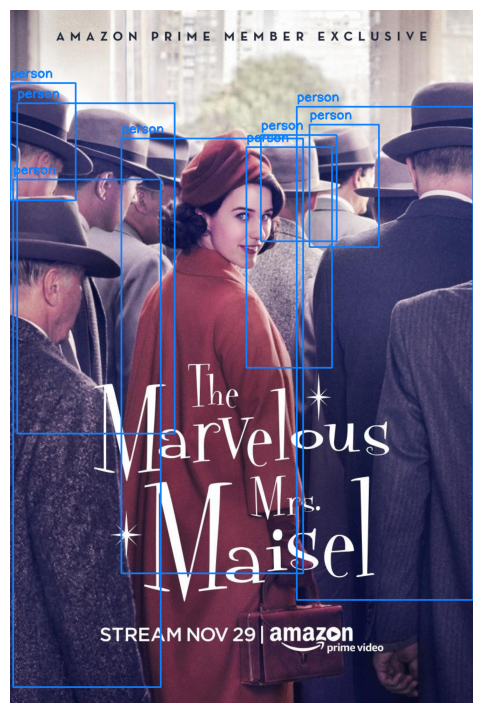

In [26]:
out = visualize_prediction(file, model, thresh=0.8)

# Еще один пример

In [27]:
file = 'detection_examples/junk_food.jpg'

Class: person, Confidence: 0.9768174290657043
Class: person, Confidence: 0.9622039794921875
Class: person, Confidence: 0.9575530290603638
Class: person, Confidence: 0.9556108117103577
Class: person, Confidence: 0.8266407251358032
Class: sandwich, Confidence: 0.8228067755699158
Class: hot dog, Confidence: 0.8058313727378845
Class: person, Confidence: 0.5006299018859863
Class: sandwich, Confidence: 0.49351951479911804
Class: person, Confidence: 0.48630720376968384
Class: bowl, Confidence: 0.44700974225997925
Class: person, Confidence: 0.442937970161438
Class: cake, Confidence: 0.29822272062301636
Class: sandwich, Confidence: 0.2690165936946869
Class: cup, Confidence: 0.24258553981781006
Class: person, Confidence: 0.2288268506526947
Class: dining table, Confidence: 0.2124510258436203
Class: cell phone, Confidence: 0.20239882171154022
Class: person, Confidence: 0.17625711858272552
Class: cell phone, Confidence: 0.17373138666152954
Class: sandwich, Confidence: 0.1664561629295349
Class: hot 

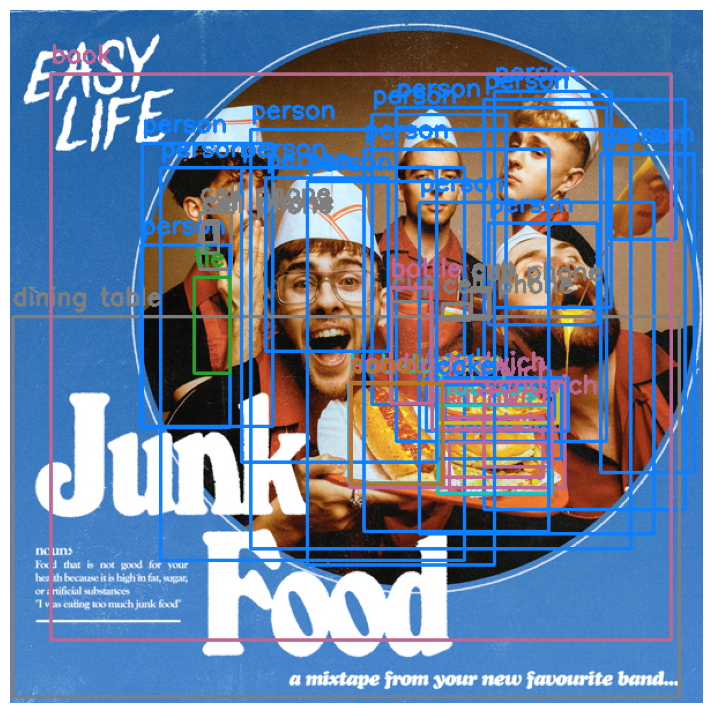

In [28]:
out = visualize_prediction(file, model)

Class: person, Confidence: 0.9768174290657043
Class: person, Confidence: 0.9622039794921875
Class: person, Confidence: 0.9575530290603638
Class: person, Confidence: 0.9556108117103577
Class: person, Confidence: 0.8266407251358032
Class: sandwich, Confidence: 0.8228067755699158
Class: hot dog, Confidence: 0.8058313727378845


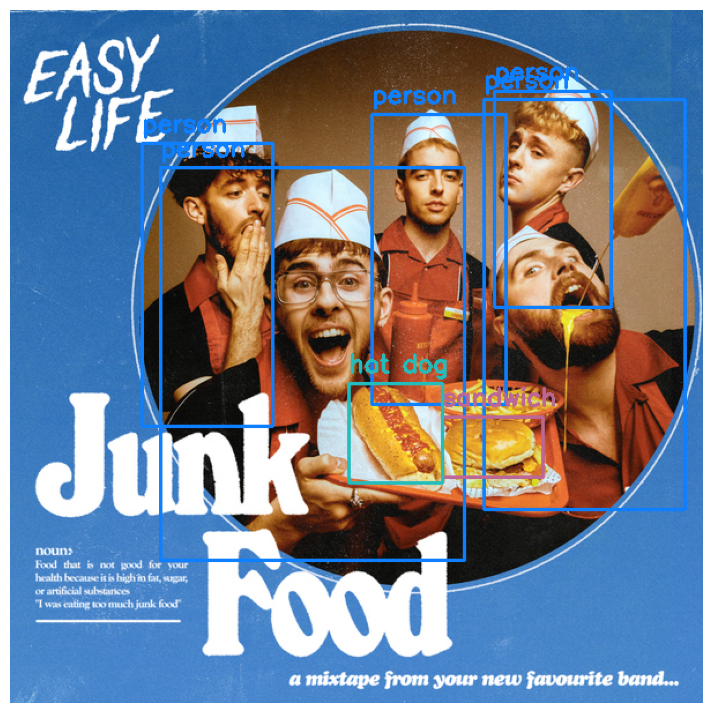

In [29]:
out = visualize_prediction(file, model, thresh=0.8)

Class: person, Confidence: 0.9768174290657043
Class: person, Confidence: 0.9622039794921875
Class: person, Confidence: 0.9575530290603638
Class: person, Confidence: 0.9556108117103577
Class: person, Confidence: 0.8266407251358032
Class: sandwich, Confidence: 0.8228067755699158
Class: hot dog, Confidence: 0.8058313727378845
Class: person, Confidence: 0.5006299018859863
Class: sandwich, Confidence: 0.49351951479911804
Class: person, Confidence: 0.48630720376968384
Class: bowl, Confidence: 0.44700974225997925
Class: person, Confidence: 0.442937970161438


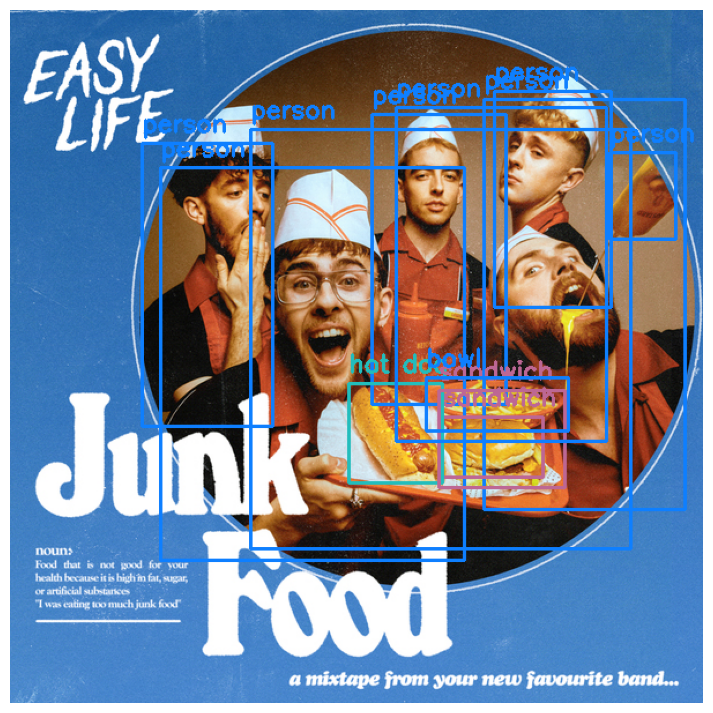

In [30]:
out = visualize_prediction(file, model, thresh=0.4)

In [31]:
list(coco_id_to_name.values())

['person',
 'bicycle',
 'car',
 'motorcycle',
 'airplane',
 'bus',
 'train',
 'truck',
 'boat',
 'traffic light',
 'fire hydrant',
 'stop sign',
 'parking meter',
 'bench',
 'bird',
 'cat',
 'dog',
 'horse',
 'sheep',
 'cow',
 'elephant',
 'bear',
 'zebra',
 'giraffe',
 'backpack',
 'umbrella',
 'handbag',
 'tie',
 'suitcase',
 'frisbee',
 'skis',
 'snowboard',
 'sports ball',
 'kite',
 'baseball bat',
 'baseball glove',
 'skateboard',
 'surfboard',
 'tennis racket',
 'bottle',
 'wine glass',
 'cup',
 'fork',
 'knife',
 'spoon',
 'bowl',
 'banana',
 'apple',
 'sandwich',
 'orange',
 'broccoli',
 'carrot',
 'hot dog',
 'pizza',
 'donut',
 'cake',
 'chair',
 'couch',
 'potted plant',
 'bed',
 'dining table',
 'toilet',
 'tv',
 'laptop',
 'mouse',
 'remote',
 'keyboard',
 'cell phone',
 'microwave',
 'oven',
 'toaster',
 'sink',
 'refrigerator',
 'book',
 'clock',
 'vase',
 'scissors',
 'teddy bear',
 'hair drier',
 'toothbrush']

# Давайте дообучимся на что-нибудь новое: номерные знаки

### Датасет Open images:
https://storage.googleapis.com/openimages/web/index.html

In [32]:
filename_to_bbox_train_dict = load_from_json('filename_to_bbox_train.json')

In [33]:
filename_to_bbox_val_dict = load_from_json('filename_to_bbox_val.json')

In [34]:
len(filename_to_bbox_train_dict), len(filename_to_bbox_val_dict)

(1313, 200)

# Визуализируем датасет

In [35]:
def visualize_from_dataset(file, filename_to_bbox_dict):
    img = cv2.imread(file, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]
    for i in range(len(filename_to_bbox_dict[file])):
        x_min, x_max, y_min, y_max = filename_to_bbox_dict[file][i]
        x_min, y_min, x_max, y_max = int(x_min * w), int(y_min * h), int(x_max * w), int(y_max * h)
        image = cv2.rectangle(img, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
    show_image(image)

In [36]:
train_filenames = list(filename_to_bbox_train_dict.keys())

In [37]:
# train_filenames

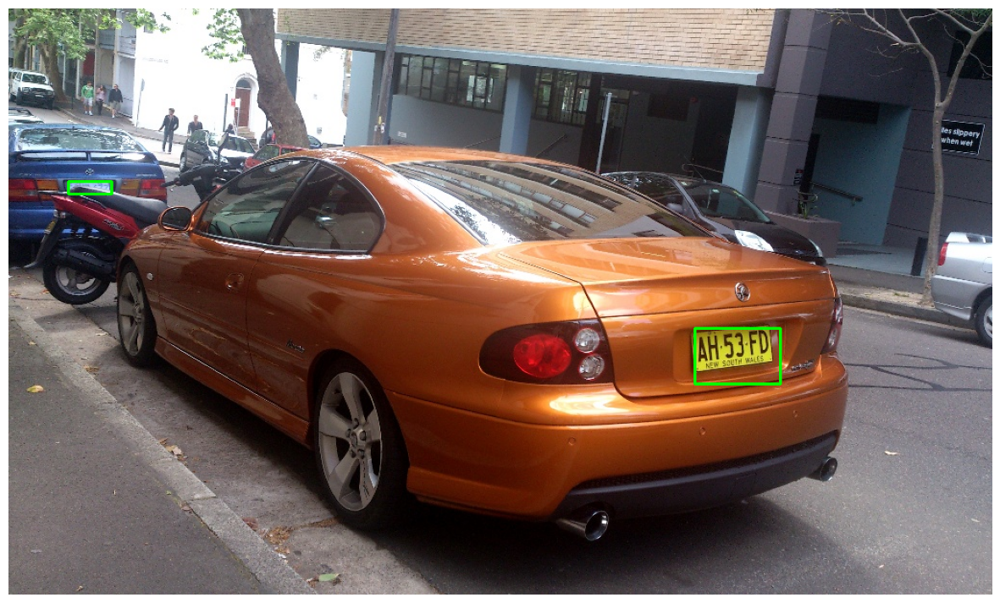

In [39]:
filename = np.random.choice(train_filenames)
visualize_from_dataset(filename, filename_to_bbox_train_dict)

In [40]:
val_filenames = list(filename_to_bbox_val_dict.keys())

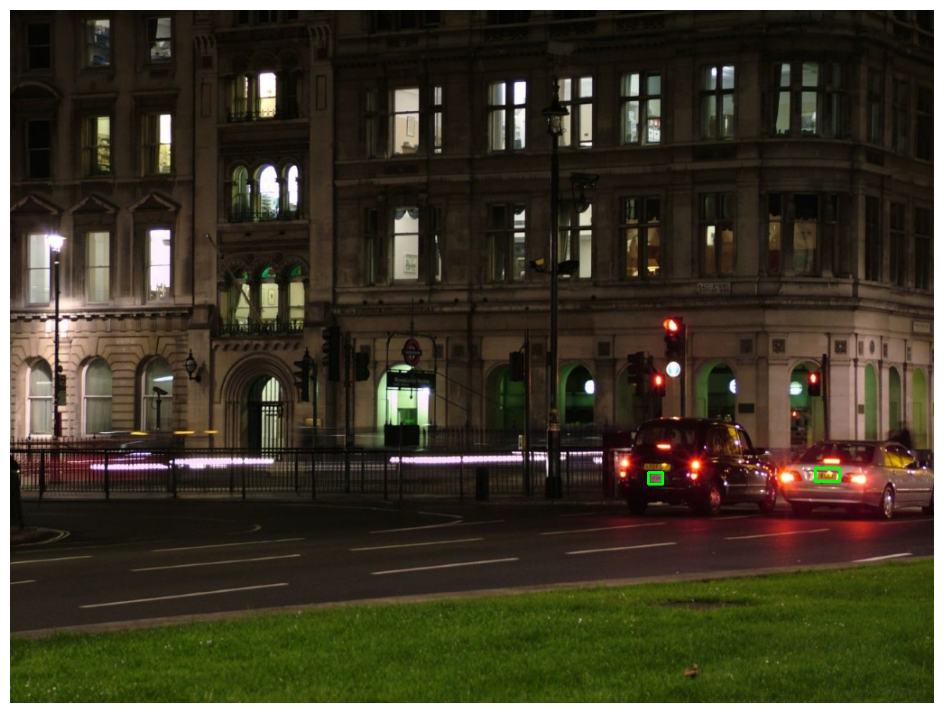

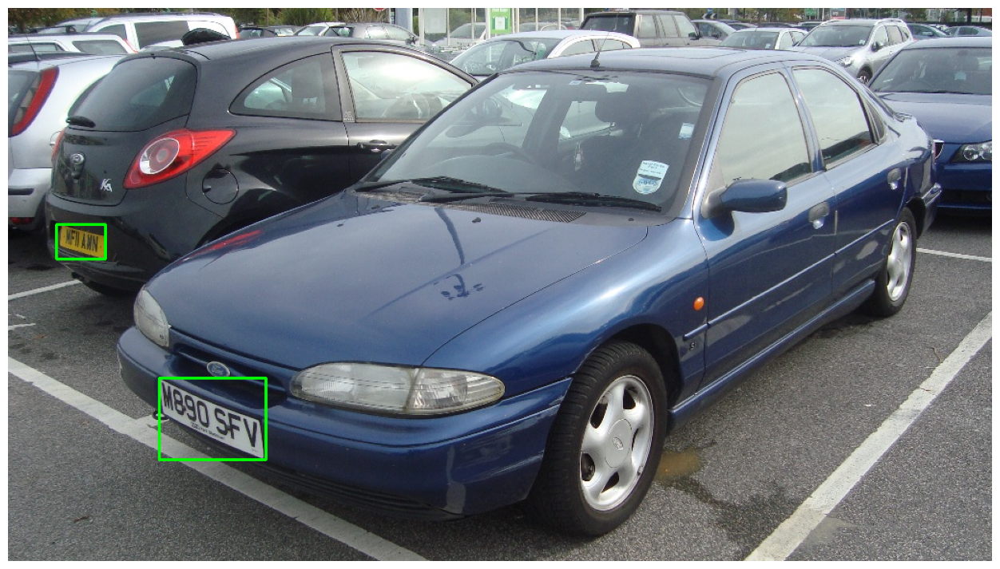

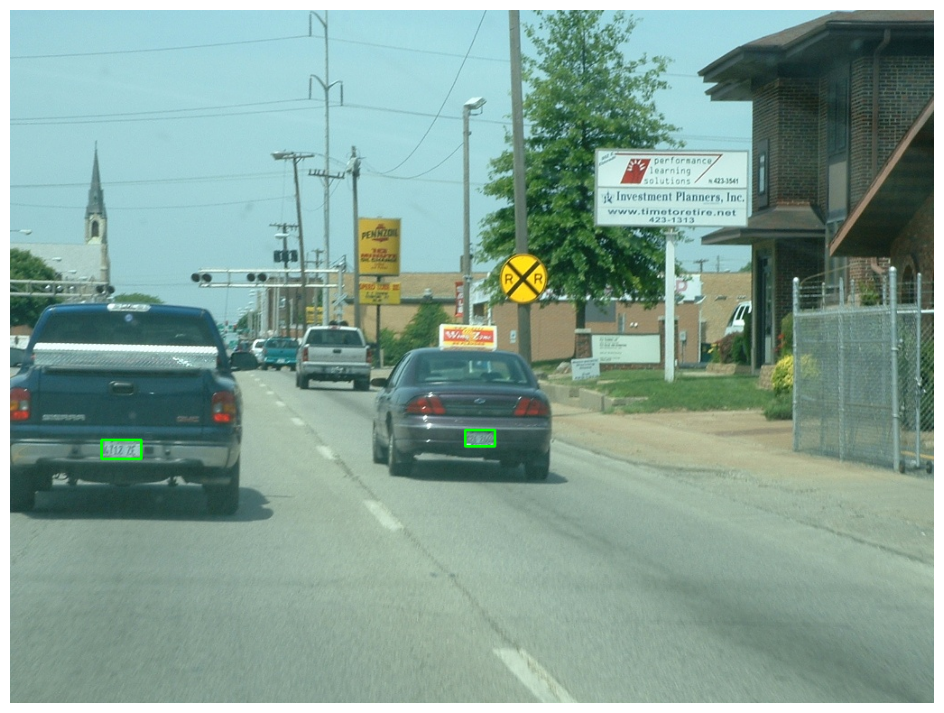

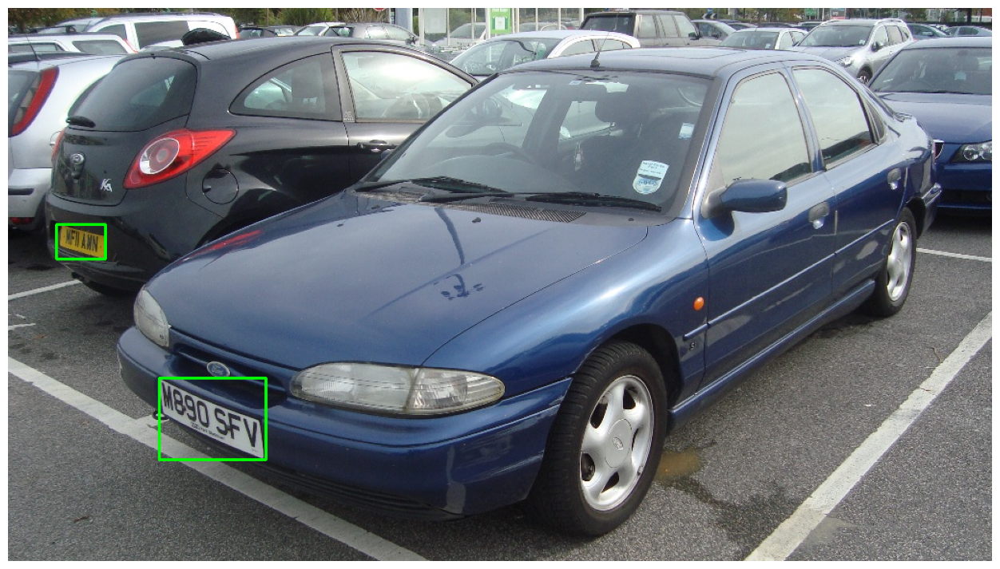

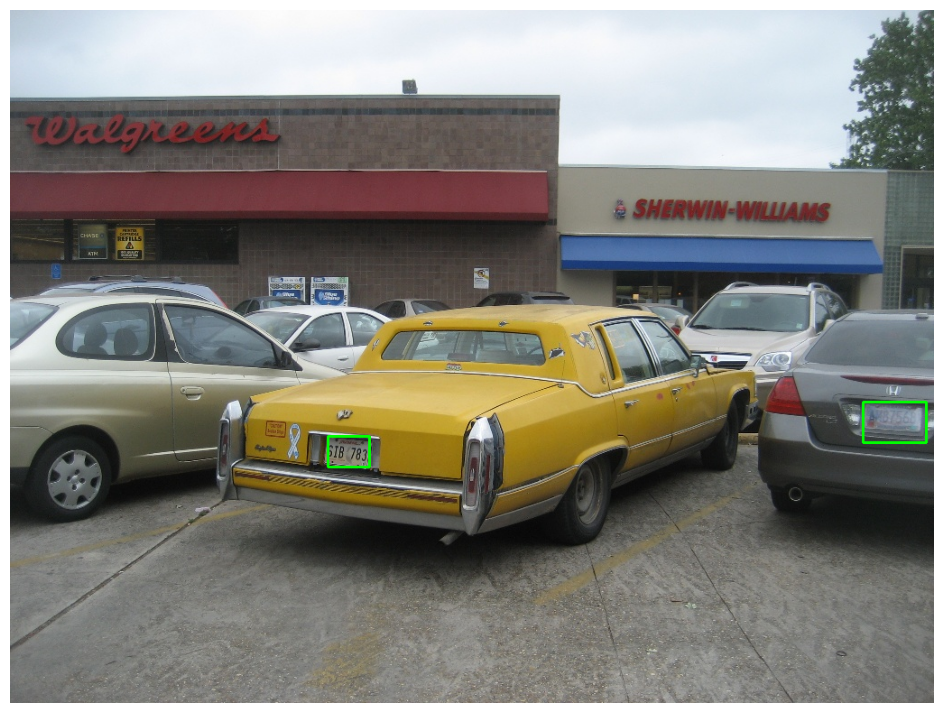

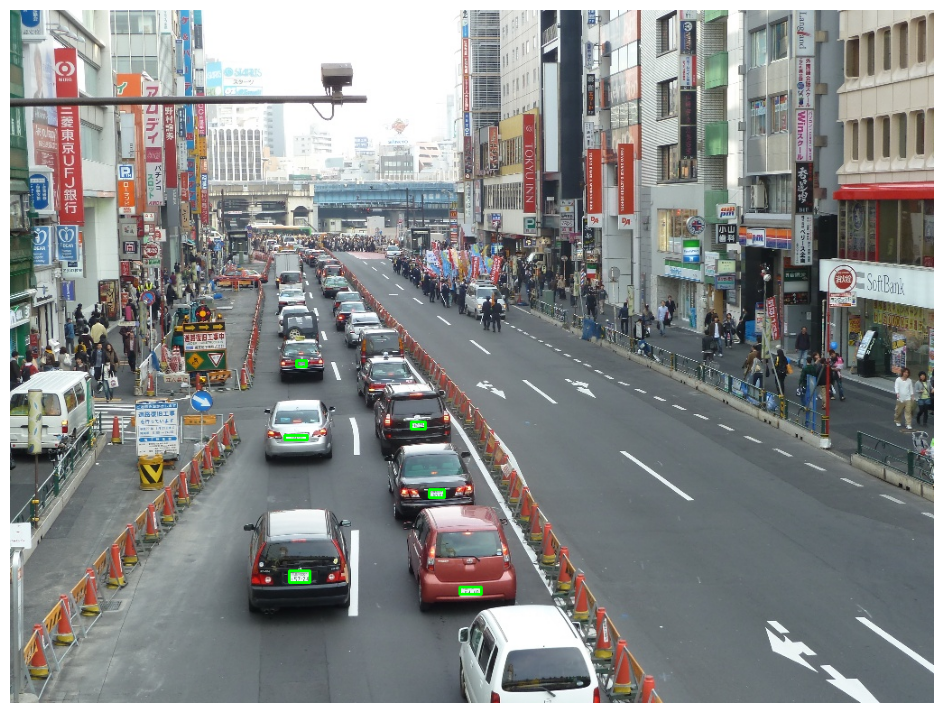

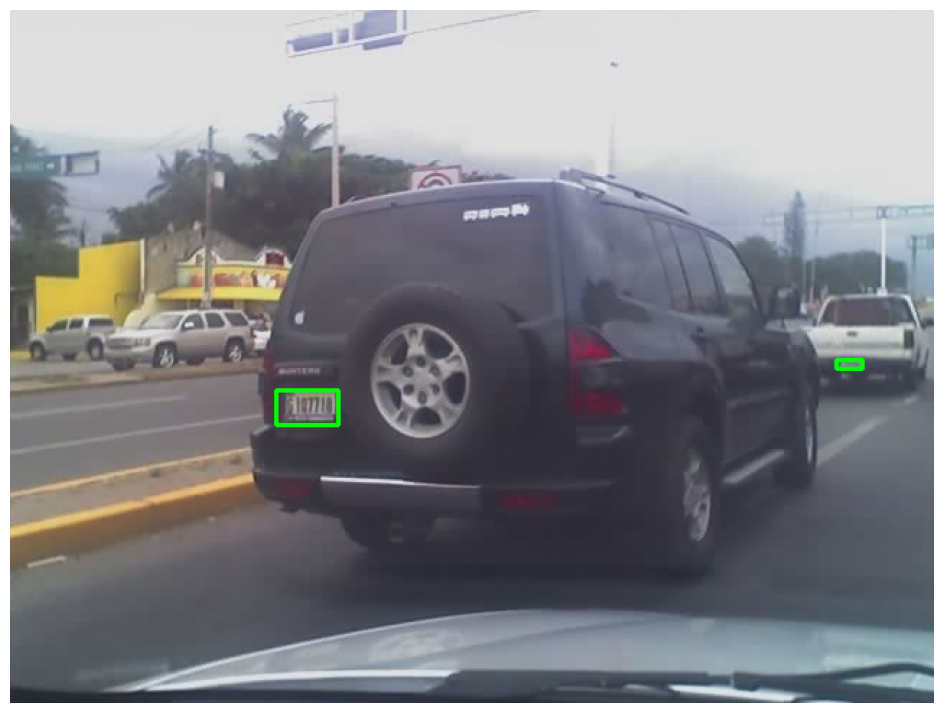

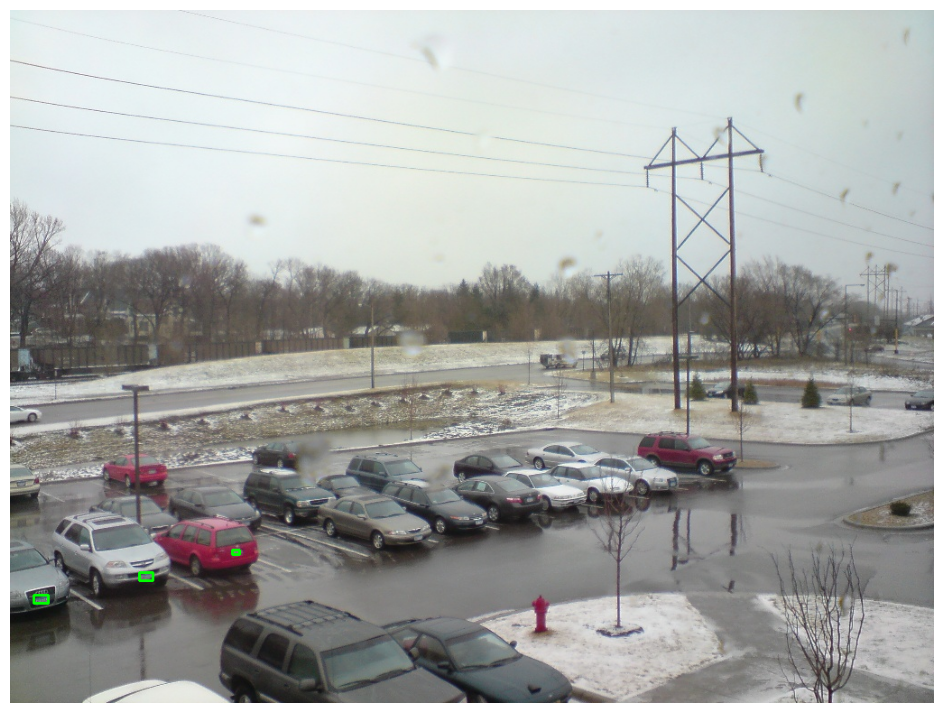

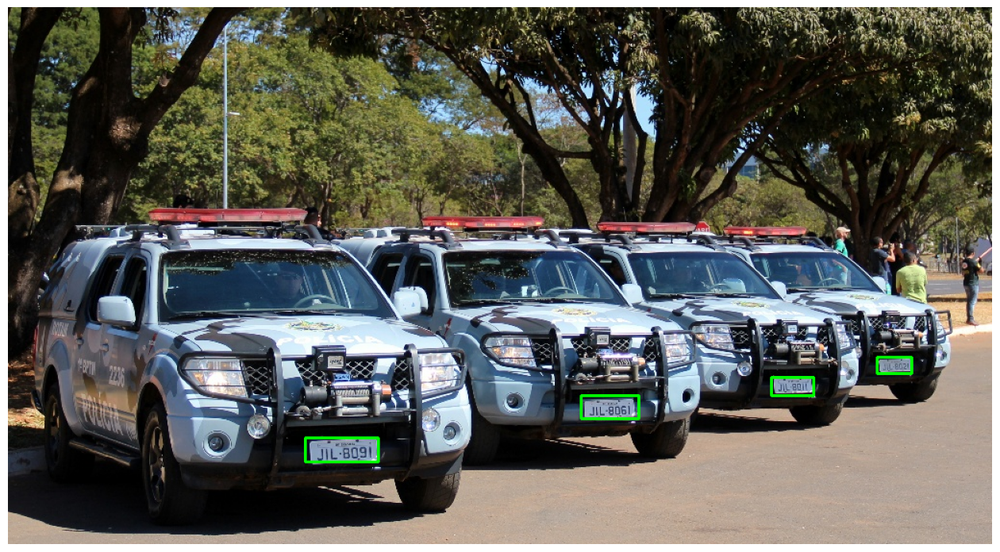

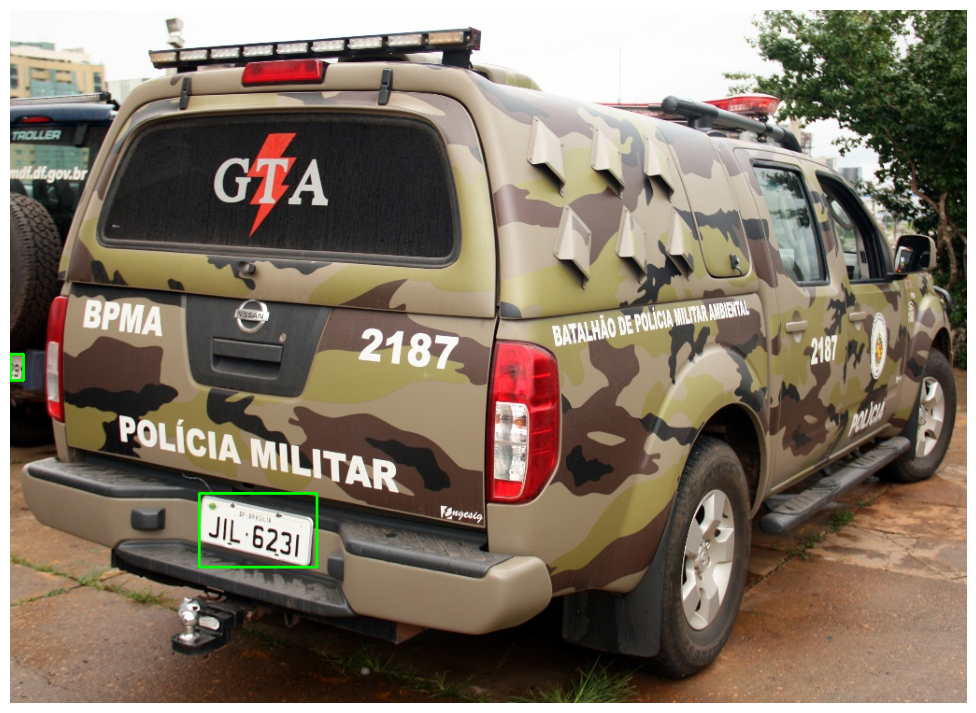

In [41]:
for filename in np.random.choice(val_filenames, 10):
    visualize_from_dataset(filename, filename_to_bbox_val_dict)

# Создадим класс датасета

In [83]:
import os
import numpy as np
import torch
import torch.utils.data
from PIL import Image
import json
from torchvision import transforms

class DetectionDataset(torch.utils.data.Dataset):
    def __init__(self, data_dict_file, transforms=None):
        self.transforms = transforms
        
        with open(data_dict_file, 'r') as f:
            self.data_dict = json.load(f)
        
        self.imgs = list(self.data_dict.keys())
        
    def __getitem__(self, idx):
        # load images ad masks
        img_path = self.imgs[idx]
        img = Image.open(img_path).convert("RGB")
        w, h = img.size

        num_objs = len(self.data_dict[img_path])
        boxes = []
        for i in range(num_objs):
            bbox = self.data_dict[img_path][i]
            xmin = bbox[0] * w
            xmax = bbox[1] * w
            ymin = bbox[2] * h
            ymax = bbox[3] * h
            boxes.append([xmin, ymin, xmax, ymax])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        # there is only one class
        labels = torch.ones((num_objs,), dtype=torch.int64)
        
        # is crowd
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])

        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["image_id"] = image_id
        target["area"] = area
        target["iscrowd"] = iscrowd

        if self.transforms is not None:
            img = self.transforms(img)

        return img, target
    
    def __len__(self):
        return len(self.imgs)

# Create transforms

In [84]:
img_transforms = transforms.Compose([
    transforms.ToTensor()
])

# Load datasets

In [85]:
# collate_fn needs for batch
def collate_fn(batch):
    return tuple(zip(*batch))

In [86]:
# use our dataset and defined transformations
train_dataset = DetectionDataset('filename_to_bbox_train.json', img_transforms)
val_dataset = DetectionDataset('filename_to_bbox_val.json', img_transforms)

# Make dataloaders

In [87]:
# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(
    train_dataset, batch_size=4, shuffle=True, num_workers=4,
    collate_fn=collate_fn, drop_last=True)

data_loader_val = torch.utils.data.DataLoader(
    val_dataset, batch_size=4, shuffle=False, num_workers=1,
    collate_fn=collate_fn, drop_last=False)

# Load model

In [88]:
model.roi_heads.box_predictor

FastRCNNPredictor(
  (cls_score): Linear(in_features=1024, out_features=2, bias=True)
  (bbox_pred): Linear(in_features=1024, out_features=8, bias=True)
)

In [89]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
# load a model pre-trained pre-trained on COCO
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True, pretrained_backbone=True)

/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained_backbone' is deprecated since 0.13 and will be removed in 0.15, please use 'weights_backbone' instead.
  warnings.warn(
/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torchvision/models/_utils.

## Собираем новую модель

In [90]:
num_classes = 2
in_channels = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_channels=in_channels, num_classes=num_classes)

In [91]:
assert model.roi_heads.box_predictor.cls_score.in_features == 1024
assert model.roi_heads.box_predictor.cls_score.out_features == 2
assert model.roi_heads.box_predictor.bbox_pred.out_features == 8

# Включить обучение только region-proposal сети и головы

In [92]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# move model to the right device
model.to(device)

for param in model.parameters():
    param.requires_grad = False
for param in model.roi_heads.box_predictor.parameters():
    param.requires_grad = True
    
# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005,
                            momentum=0.9, weight_decay=0.0005)

In [93]:
len(params)

4

In [94]:
# and a learning rate scheduler which decreases the learning rate by
# 10x every 3 epochs
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                               step_size=30,
                                               gamma=0.1)

# Обучение 

In [95]:
from engine import evaluate

In [96]:
import math
import sys
import time
import torch

from coco_utils import get_coco_api_from_dataset
from coco_eval import CocoEvaluator
import utils

def train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq):
    model.train()
    metric_logger = utils.MetricLogger(delimiter="  ")
    metric_logger.add_meter('lr', utils.SmoothedValue(window_size=1, fmt='{value:.6f}'))
    header = 'Epoch: [{}]'.format(epoch)

    lr_scheduler = None
    if epoch == 0:
        warmup_factor = 1. / 1000
        warmup_iters = min(1000, len(data_loader) - 1)

        lr_scheduler = utils.warmup_lr_scheduler(optimizer, warmup_iters, warmup_factor)

    for images, targets in metric_logger.log_every(data_loader, print_freq, header):
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        # получим предсказания сети (словарь)        
        loss_dict = model(images, targets)
        # cложим их
        losses = sum(value for value in loss_dict.values())
        loss_value = losses.item()

        if not math.isfinite(loss_value):
            print("Loss is {}, stopping training".format(loss_value))
            #print(loss_dict_reduced)
            sys.exit(1)

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        if lr_scheduler is not None:
            lr_scheduler.step()

        metric_logger.update(loss=losses, **loss_dict)
        metric_logger.update(lr=optimizer.param_groups[0]["lr"])

# Запустим обучение

In [97]:

num_epochs=10
for epoch in range(num_epochs):
    train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=50)
    # update the learning rate
    lr_scheduler.step()
    # evaluate on the test dataset
    evaluate(model, data_loader_val, device='cpu')
    torch.save(model.state_dict(), 'test_model_state_dict_last.pth')

Traceback (most recent call last):
  File "<string>", line 1, in <module>
Traceback (most recent call last):
  File "<string>", line 1, in <module>
  File "/Users/max/.conda/envs/hw6/lib/python3.10/multiprocessing/spawn.py", line 116, in spawn_main
  File "/Users/max/.conda/envs/hw6/lib/python3.10/multiprocessing/spawn.py", line 116, in spawn_main
    exitcode = _main(fd, parent_sentinel)
  File "/Users/max/.conda/envs/hw6/lib/python3.10/multiprocessing/spawn.py", line 126, in _main
    exitcode = _main(fd, parent_sentinel)
  File "/Users/max/.conda/envs/hw6/lib/python3.10/multiprocessing/spawn.py", line 126, in _main
    self = reduction.pickle.load(from_parent)
AttributeError: Can't get attribute 'DetectionDataset' on <module '__main__' (built-in)>
    self = reduction.pickle.load(from_parent)
AttributeError: Can't get attribute 'DetectionDataset' on <module '__main__' (built-in)>
Traceback (most recent call last):
  File "<string>", line 1, in <module>
  File "/Users/max/.conda/envs

Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1163, in _try_get_data
    #
  File "/Users/max/.conda/envs/hw6/lib/python3.10/multiprocessing/queues.py", line 113, in get
    if not self._poll(timeout):
  File "/Users/max/.conda/envs/hw6/lib/python3.10/multiprocessing/connection.py", line 262, in poll
    return self._poll(timeout)
  File "/Users/max/.conda/envs/hw6/lib/python3.10/multiprocessing/connection.py", line 429, in _poll
    r = wait([self], timeout)
  File "/Users/max/.conda/envs/hw6/lib/python3.10/multiprocessing/connection.py", line 936, in wait
    ready = selector.select(timeout)
  File "/Users/max/.conda/envs/hw6/lib/python3.10/selectors.py", line 416, in select
    fd_event_list = self._selector.poll(timeout)
  File "/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torch/utils/data/_utils/signal_handling.py", line 66, in handler
    _error_if_any_worker_fails()
RuntimeError

## Сохраним модель

In [61]:
print(model.state_dict())


OrderedDict([('backbone.body.conv1.weight', tensor([[[[ 1.3335e-02,  1.4664e-02, -1.5351e-02,  ..., -4.0896e-02,
           -4.3034e-02, -7.0755e-02],
          [ 4.1205e-03,  5.8477e-03,  1.4948e-02,  ...,  2.2060e-03,
           -2.0912e-02, -3.8517e-02],
          [ 2.2331e-02,  2.3595e-02,  1.6120e-02,  ...,  1.0281e-01,
            6.2641e-02,  5.1977e-02],
          ...,
          [-9.0349e-04,  2.7767e-02, -1.0105e-02,  ..., -1.2722e-01,
           -7.6604e-02,  7.8453e-03],
          [ 3.5894e-03,  4.8006e-02,  6.2051e-02,  ...,  2.4267e-02,
           -3.3662e-02, -1.5709e-02],
          [-8.0029e-02, -3.2238e-02, -1.7808e-02,  ...,  3.5359e-02,
            2.2439e-02,  1.7077e-03]],

         [[-1.8452e-02,  1.1415e-02,  2.3850e-02,  ...,  5.3736e-02,
            4.4022e-02, -9.4675e-03],
          [-7.7273e-03,  1.8890e-02,  6.7981e-02,  ...,  1.5956e-01,
            1.4606e-01,  1.1999e-01],
          [-4.6013e-02, -7.6075e-02, -8.9648e-02,  ...,  1.2108e-01,
            1.

In [62]:
torch.save(model.state_dict(), 'test_model_state_dict_workshop_final.pth')

# Загрузим сохраненную модель

In [63]:
model.load_state_dict(torch.load('./model_state_dict_final.pth'))

Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3378, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/var/folders/4c/gl4vb4t52cb7gx03zf6ywqz40000gp/T/ipykernel_13639/797434356.py", line 1, in <module>
    model.load_state_dict(torch.load('./model_state_dict_final.pth'))
  File "/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torch/serialization.py", line 713, in load
    :func:`torch.load()` unless `weights_only` parameter is set to `True`,
  File "/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torch/serialization.py", line 930, in _legacy_load
    result = unpickler.load()
  File "/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torch/serialization.py", line 876, in persistent_load
    if all(saved_id[1:]):
  File "/Users/max/.conda/envs/hw6/lib/python3.10/site-packages/torch/serialization.py", line 175, in default_restore_location
    'torch.lo

In [64]:
model.to(device)

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [66]:
evaluate(model, data_loader_val, device=device)

creating index...
index created!


TypeError: 'numpy.float64' object cannot be interpreted as an integer

# Визуализируем предсказания для валидации

In [71]:
def visualize_prediction_plate(file, model, device='cpu', verbose=True, thresh=0.0,
                               n_colors=None, id_to_name=None):
    img = Image.open(file)
    img_tensor = val_transform(img)
    model.to(device)
    model.eval()
    with torch.no_grad():
        predictions = model(img_tensor.to(device)) # list of size 1
    prediction = predictions[0]
    
    if n_colors is None:
        n_colors = model.roi_heads.box_predictor.cls_score.out_features
    
    palette = sns.color_palette(None, n_colors)
    
    # visualize
    img = cv2.imread(file, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]
    image = img
    for i in range(len(prediction['boxes'])):
        x_min, y_min, x_max, y_max = map(int, prediction['boxes'][i].tolist())
        label = int(prediction['labels'][i].cpu())
        score = float(prediction['scores'][i].cpu())
        name = id_to_name[label]
        color = palette[label]
        if verbose:
            if score > thresh:
                print ('Class: {}, Confidence: {}'.format(name, score))
        if score > thresh:
            image = cv2.rectangle(img, (x_min, y_min), (x_max, y_max), np.array(color) * 255, 2)
            cv2.putText(image, name, (x_min, y_min-10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, np.array(color) * 255, 2)
    show_image(image)
    return prediction

# Визуализируем предсказания

In [72]:
val_filenames = list(filename_to_bbox_val_dict.keys())

In [73]:
filename = np.random.choice(val_filenames)
print(filename)

./number_plates/00048.jpg


In [74]:
filename = np.random.choice(val_filenames)
visualize_prediction_plate(filename, model, id_to_name={1: 'plate'}, thresh=0.5)

Class: plate, Confidence: 0.7634437680244446
Class: plate, Confidence: 0.7571125030517578
Class: plate, Confidence: 0.7400680780410767
Class: plate, Confidence: 0.7399197816848755
Class: plate, Confidence: 0.7256184220314026
Class: plate, Confidence: 0.724046528339386
Class: plate, Confidence: 0.7178585529327393
Class: plate, Confidence: 0.7121519446372986
Class: plate, Confidence: 0.7048815488815308
Class: plate, Confidence: 0.7028688788414001
Class: plate, Confidence: 0.7022040486335754
Class: plate, Confidence: 0.6996793150901794
Class: plate, Confidence: 0.6995779871940613
Class: plate, Confidence: 0.6994079947471619
Class: plate, Confidence: 0.6991541981697083
Class: plate, Confidence: 0.6894248127937317
Class: plate, Confidence: 0.687164843082428
Class: plate, Confidence: 0.6854701042175293
Class: plate, Confidence: 0.6842139959335327
Class: plate, Confidence: 0.6840295195579529
Class: plate, Confidence: 0.6827197670936584
Class: plate, Confidence: 0.6813218593597412
Class: plate

/var/folders/4c/gl4vb4t52cb7gx03zf6ywqz40000gp/T/ipykernel_13639/526802441.py:22: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  plt.show()


{'boxes': tensor([[ 462.3905,  357.9189,  552.0938,  442.9257],
         [  48.5002,  382.0685,   97.7915,  417.3651],
         [ 118.8243,  382.3218,  231.3311,  406.8604],
         [ 471.8281,  376.6021,  548.6716,  419.7575],
         [  39.3093,  382.6518,  145.0337,  409.4767],
         [ 126.5355,  377.4372,  170.0089,  413.4761],
         [ 444.1123,  380.4858,  589.5866,  433.9496],
         [ 824.5972,  368.3855, 1008.2126,  468.8739],
         [ 509.2481,  339.1433,  587.3851,  422.5920],
         [ 164.2878,  386.7708,  246.2386,  409.2943],
         [ 524.8305,  347.8052,  582.8969,  400.9664],
         [ 161.6817,  377.0886,  251.7433,  401.6493],
         [  48.5456,  394.5994,  131.9811,  420.2535],
         [ 475.2232,  376.8611,  586.8022,  406.5298],
         [ 190.5090,  384.2350,  214.7713,  402.0432],
         [ 757.8329,  353.5732,  826.4839,  386.0034],
         [ 130.0400,  382.0460,  163.3714,  403.1589],
         [   2.6579,  381.7472,   77.7970,  413.5194],
 